## Visualización Infectados de Covid 19

In [24]:
# Importamos todos los paquetes que vamos a necesitar
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from math import sqrt

In [25]:
# cargamos nuestro dataset
data = pd.read_csv('datasets/positivos_covid.csv', sep=';')

In [26]:
data.head()

,FECHA_CORTE,UUID,DEPARTAMENTO,PROVINCIA,DISTRITO,METODODX,EDAD,SEXO,FECHA_RESULTADO
0,20210306,7320cabdc1aaca6c59014cae76a134e6,AYACUCHO,HUAMANGA,AYACUCHO,PR,31.0,FEMENINO,20200911.0
1,20210306,e81602051997ace8340bb8c18fe24c65,ICA,ICA,ICA,PR,32.0,FEMENINO,20200911.0
2,20210306,71ecb6bccb248b0bb2ac72ed51b5e979,AYACUCHO,HUAMANGA,AYACUCHO,PR,42.0,FEMENINO,20200911.0
3,20210306,566af4276cbe9359abe93f9aa86396c3,ICA,ICA,PARCONA,PR,53.0,FEMENINO,20200911.0
4,20210306,027561e9d126e7c283d79c02cede562d,JUNIN,HUANCAYO,EL TAMBO,PR,52.0,FEMENINO,20200911.0


In [27]:
# miramos ahora las tipologia de variables que tenemos
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1371176 entries, 0 to 1371175
Data columns (total 9 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   FECHA_CORTE      1371176 non-null  int64  
 1   UUID             1371176 non-null  object 
 2   DEPARTAMENTO     1371176 non-null  object 
 3   PROVINCIA        1371176 non-null  object 
 4   DISTRITO         1371176 non-null  object 
 5   METODODX         1371176 non-null  object 
 6   EDAD             1370866 non-null  float64
 7   SEXO             1371176 non-null  object 
 8   FECHA_RESULTADO  1369153 non-null  float64
dtypes: float64(2), int64(1), object(6)
memory usage: 94.2+ MB


In [28]:
data.describe()

,FECHA_CORTE,EDAD,FECHA_RESULTADO
count,1371176.0,1.370866e+06,1.369153e+06
mean,20210306.0,4.227923e+01,2.020318e+07
std,0.0,1.784619e+01,4.098231e+03
min,20210306.0,0.000000e+00,2.020031e+07
25%,20210306.0,2.900000e+01,2.020071e+07
50%,20210306.0,4.100000e+01,2.020083e+07
75%,20210306.0,5.400000e+01,2.021010e+07
max,20210306.0,1.210000e+02,2.021031e+07


In [29]:
data['DEPARTAMENTO'].unique()

array(['AYACUCHO', 'ICA', 'JUNIN', 'HUANUCO', 'HUANCAVELICA', 'LIMA',
       'LIMA REGION', 'CALLAO', 'PIURA', 'ANCASH', 'LA LIBERTAD',
       'LAMBAYEQUE', 'TUMBES', 'CAJAMARCA', 'SAN MARTIN', 'UCAYALI',
       'AREQUIPA', 'CUSCO', 'MOQUEGUA', 'PUNO', 'TACNA', 'MADRE DE DIOS',
       'APURIMAC', 'PASCO', 'AMAZONAS', 'LORETO'], dtype=object)

In [30]:
data['EDAD'].head()

0    31.0
1    32.0
2    42.0
3    53.0
4    52.0
Name: EDAD, dtype: float64

In [31]:
data['EDAD'].mean()

42.27923371066173

<AxesSubplot:xlabel='SEXO', ylabel='count'>

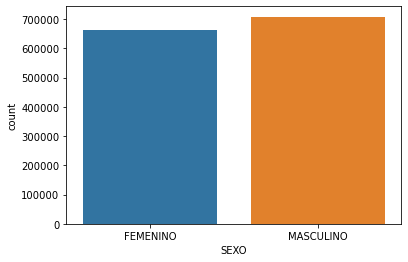

In [32]:
# Visualizar grafico de barras según el sexo
sns.countplot(x='SEXO', data=data)

<AxesSubplot:xlabel='DEPARTAMENTO', ylabel='count'>

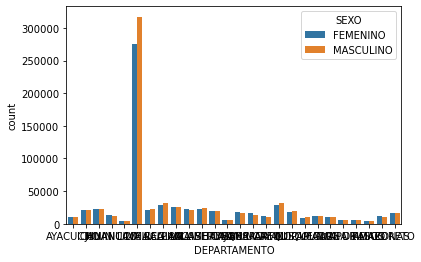

In [33]:
# Visualizar grafico de barras según el sexo
sns.countplot(x='DEPARTAMENTO', data=data, hue='SEXO')

<AxesSubplot:xlabel='METODODX', ylabel='count'>

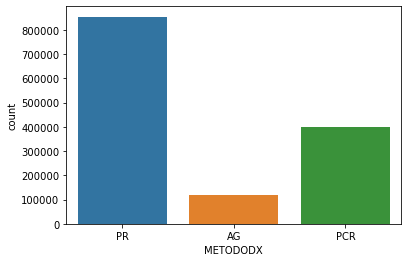

In [34]:
# Visualizar grafico de barras según el METODODX
sns.countplot(x='METODODX', data=data)

In [35]:
data['DEPARTAMENTO'].head()

0    AYACUCHO
1         ICA
2    AYACUCHO
3         ICA
4       JUNIN
Name: DEPARTAMENTO, dtype: object

In [36]:
data['METODODX'].unique()

array(['PR', 'AG', 'PCR'], dtype=object)

In [37]:
data.drop(['FECHA_CORTE', 'UUID'], axis=1,inplace=True)

In [38]:
data['FECHA_RESULTADO'] = pd.to_datetime(data['FECHA_RESULTADO'], format='%Y%m%d')
data['ANIO'] = (data['FECHA_RESULTADO'].dt.year)
data['MES'] = (data['FECHA_RESULTADO'].dt.month)
data['XMES'] = (data['FECHA_RESULTADO'].dt.month_name().str[:3])
data['DIA'] = (data['FECHA_RESULTADO'].dt.day)

In [39]:
data.head()

,DEPARTAMENTO,PROVINCIA,DISTRITO,METODODX,EDAD,SEXO,FECHA_RESULTADO,ANIO,MES,XMES,DIA
0,AYACUCHO,HUAMANGA,AYACUCHO,PR,31.0,FEMENINO,2020-09-11,2020.0,9.0,Sep,11.0
1,ICA,ICA,ICA,PR,32.0,FEMENINO,2020-09-11,2020.0,9.0,Sep,11.0
2,AYACUCHO,HUAMANGA,AYACUCHO,PR,42.0,FEMENINO,2020-09-11,2020.0,9.0,Sep,11.0
3,ICA,ICA,PARCONA,PR,53.0,FEMENINO,2020-09-11,2020.0,9.0,Sep,11.0
4,JUNIN,HUANCAYO,EL TAMBO,PR,52.0,FEMENINO,2020-09-11,2020.0,9.0,Sep,11.0


In [40]:
data['ANIO'].unique()

array([2020., 2021.,   nan])

<AxesSubplot:>

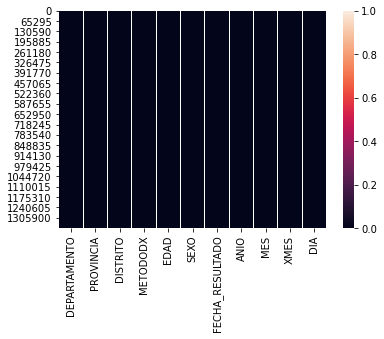

In [41]:
data.isnull()
sns.heatmap(data.isnull())

<AxesSubplot:xlabel='ANIO', ylabel='count'>

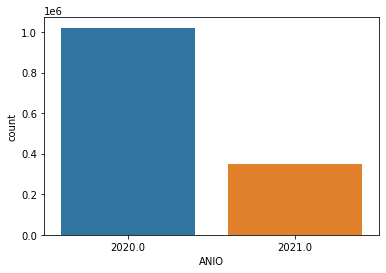

In [42]:
sns.countplot(x='ANIO', data=data)

In [43]:
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline

In [22]:
data['DEPARTAMENTO'].iplot(kind='box')

In [67]:
diccionario = {'DEPARTAMENTO':data['DEPARTAMENTO'], 'MES': data['MES'], 'ANIO': data['ANIO']}
dataframe = pd.DataFrame(diccionario)
dataframe

,DEPARTAMENTO,MES,ANIO
0,AYACUCHO,9.0,2020.0
1,ICA,9.0,2020.0
2,AYACUCHO,9.0,2020.0
3,ICA,9.0,2020.0
4,JUNIN,9.0,2020.0
...,...,...,...
1371171,CALLAO,8.0,2020.0
1371172,CALLAO,8.0,2020.0
1371173,CALLAO,8.0,2020.0
1371174,CALLAO,8.0,2020.0


In [55]:
data['DEPARTAMENTO'].unique()

array(['AYACUCHO', 'ICA', 'JUNIN', 'HUANUCO', 'HUANCAVELICA', 'LIMA',
       'LIMA REGION', 'CALLAO', 'PIURA', 'ANCASH', 'LA LIBERTAD',
       'LAMBAYEQUE', 'TUMBES', 'CAJAMARCA', 'SAN MARTIN', 'UCAYALI',
       'AREQUIPA', 'CUSCO', 'MOQUEGUA', 'PUNO', 'TACNA', 'MADRE DE DIOS',
       'APURIMAC', 'PASCO', 'AMAZONAS', 'LORETO'], dtype=object)

In [56]:
data['DEPARTAMENTO'].nunique()

26

In [57]:
dataframe = pd.DataFrame(np.random.randn(100,26), columns=['AYACUCHO', 'ICA', 'JUNIN', 'HUANUCO', 'HUANCAVELICA', 'LIMA',
       'LIMA REGION', 'CALLAO', 'PIURA', 'ANCASH', 'LA LIBERTAD',
       'LAMBAYEQUE', 'TUMBES', 'CAJAMARCA', 'SAN MARTIN', 'UCAYALI',
       'AREQUIPA', 'CUSCO', 'MOQUEGUA', 'PUNO', 'TACNA', 'MADRE DE DIOS',
       'APURIMAC', 'PASCO', 'AMAZONAS', 'LORETO'])
dataframe

,AYACUCHO,ICA,JUNIN,HUANUCO,HUANCAVELICA,LIMA,LIMA REGION,CALLAO,PIURA,ANCASH,...,AREQUIPA,CUSCO,MOQUEGUA,PUNO,TACNA,MADRE DE DIOS,APURIMAC,PASCO,AMAZONAS,LORETO
0,-0.600634,-0.241347,-0.814880,0.260561,-0.118695,-0.925002,-1.727423,-0.842001,0.468157,0.292450,...,0.804244,-0.204081,-1.214439,-0.703897,0.780808,0.328762,-0.300535,0.240022,-0.808058,1.451104
1,-1.596498,-0.884955,-0.951210,0.336755,-0.912515,1.817182,0.105148,-0.398360,-0.397602,-0.664009,...,-1.120276,-1.893646,1.173371,-0.018401,-0.455299,1.017936,-0.319751,-0.333065,-1.486881,-0.379967
2,1.001978,0.695490,0.714155,0.924219,-0.459590,-0.065860,-0.669981,0.295552,0.361138,-0.820791,...,0.338478,0.634809,-0.701707,0.039758,-0.374920,-2.064224,0.950314,0.378174,0.572419,1.851123
3,2.244688,-0.467932,-0.317911,-0.445699,0.435957,0.927111,0.195695,1.683832,0.858392,0.310444,...,-0.170758,-0.933000,-0.014149,-0.769219,-1.406653,-0.200253,0.978183,-0.723409,-1.027419,0.012606
4,1.323832,1.914920,0.111157,-0.224599,0.786880,-1.392438,1.661414,0.527359,0.676425,0.004320,...,0.375718,0.375635,1.486110,1.279534,-1.358973,-0.613845,0.144396,-0.910829,1.257034,-0.488158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.188002,-1.461309,-1.871471,0.680410,-1.297793,1.530290,-0.826004,0.746279,-0.048071,0.078943,...,-2.126432,-0.188345,0.768186,-0.776519,1.299852,0.242886,-1.354627,-0.796549,-0.129854,-0.228320
96,-0.126023,0.404350,0.689629,-0.577916,0.725972,1.549649,0.597178,-0.236399,0.710116,-1.441377,...,0.610560,-1.041543,-0.606081,-0.033792,0.649784,-1.853591,-0.715813,-2.348049,-0.427276,0.197096
97,0.019044,-1.226575,1.208963,1.451134,-0.238382,0.169825,1.184018,-1.171899,-0.611813,0.532431,...,0.818149,1.150840,-1.398199,1.182996,-0.555999,1.179907,-0.965615,0.950877,-1.413077,0.688959
98,0.709548,1.243150,-1.202401,-2.629750,0.140961,-0.373949,-1.809663,-0.671794,-0.452280,0.179598,...,0.213602,0.064713,-0.289846,0.429302,0.724077,0.290011,-0.123981,1.094452,1.861479,0.245930


In [61]:
dataframe.iplot(kind='box')

In [62]:
dataframe.iplot(kind='scatter',x='PASCO',y='SAN MARTIN',mode='markers')